In [1]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
import math
%matplotlib inline 

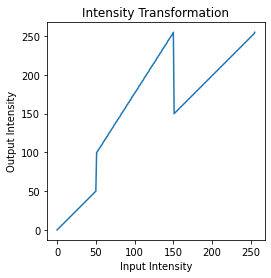

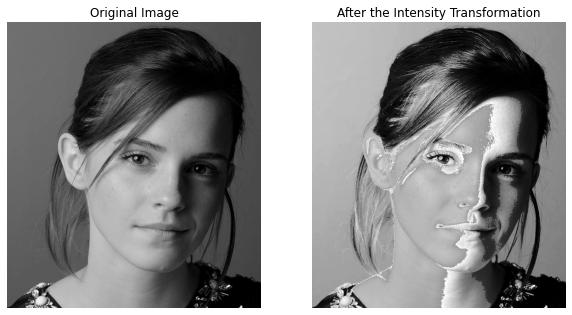

In [3]:
Img1 = cv.imread(r"emma_gray.jpg", cv.IMREAD_GRAYSCALE)
assert Img1 is not None

inp1 = np.linspace(0,50,51)
inp2 = np.linspace(100,255,100)
inp3 = np.linspace(150,255,105)

Out_int = np.concatenate((inp1,inp2,inp3),axis=0).astype(np.uint8)
fig1, ax1 = plt.subplots()
ax1.plot(Out_int)
ax1.title.set_text("Intensity Transformation")
ax1.set_xlabel('Input Intensity')
ax1.set_ylabel('Output Intensity')
ax1.set_aspect('equal')
assert len(Out_int) == 256

Out_Img1 = cv.LUT(Img1, Out_int)

fig, ax = plt.subplots(1, 2, figsize=(10,10))
ax[0].axis('off')
ax[0].title.set_text("Original Image")
ax[0].imshow(Img1 , cmap='gray')
ax[1].axis('off')
ax[1].title.set_text("After the Intensity Transformation")
ax[1].imshow(Out_Img1 , cmap='gray')

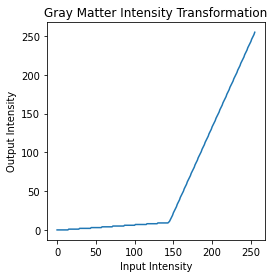

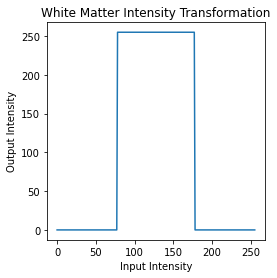

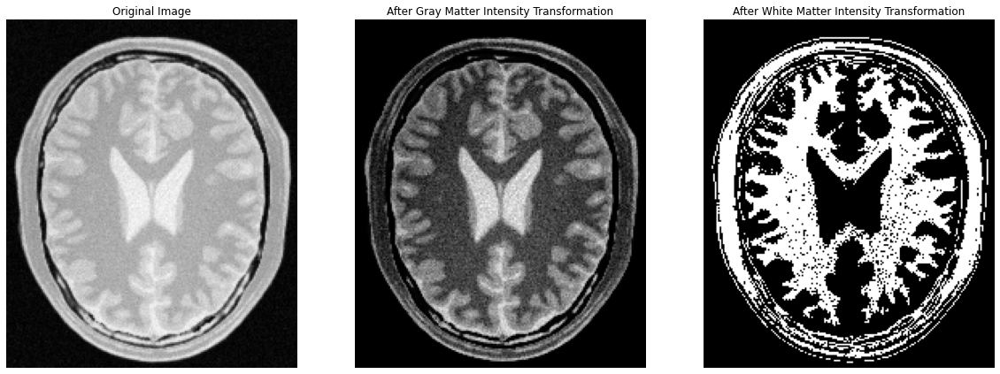

In [6]:
Img2 = cv.imread(r"brain_proton_density_slice.png", cv.IMREAD_GRAYSCALE)
assert Img2 is not None

inpg1 = np.linspace(0, 10, 145)
inpg2 = np.linspace(11, 255, 111)
Out_int = np.concatenate((inpg1,inpg2),axis=0).astype(np.uint8)
fig1, ax1 = plt.subplots()
ax1.plot(Out_int)
ax1.title.set_text("Gray Matter Intensity Transformation")
ax1.set_xlabel('Input Intensity')
ax1.set_ylabel('Output Intensity')
ax1.set_aspect('equal')
ax1.set_xlabel('Input Intensity')
ax1.set_ylabel('Output Intensity')
assert len(Out_int) == 256

Out_Img1 = cv.LUT(Img2, Out_int)

inpw1= np.zeros(78)
inpw2 = 255*np.ones(100)
inpw3= np.zeros(78)
Out_int = np.concatenate((inpw1, inpw2, inpw3),axis=0).astype(np.uint8)
fig1, ax1 = plt.subplots()
ax1.plot(Out_int)
ax1.title.set_text("White Matter Intensity Transformation")
ax1.set_xlabel('Input Intensity')
ax1.set_ylabel('Output Intensity')
ax1.set_aspect('equal')
ax1.set_xlabel('Input Intensity')
ax1.set_ylabel('Output Intensity')
assert len(Out_int) == 256

Out_Img2 = cv.LUT(Img2, Out_int)

fig, ax = plt.subplots(1, 3, figsize=(20,20))
ax[0].axis('off')
ax[0].title.set_text("Original Image")
ax[0].imshow(Img2 , cmap='gray')
ax[1].axis('off')
ax[1].title.set_text("After Gray Matter Intensity Transformation")
ax[1].imshow(Out_Img1 , cmap='gray')
ax[2].axis('off')
ax[2].title.set_text("After White Matter Intensity Transformation")
ax[2].imshow(Out_Img2 , cmap='gray')


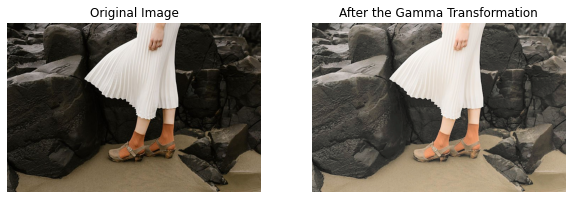

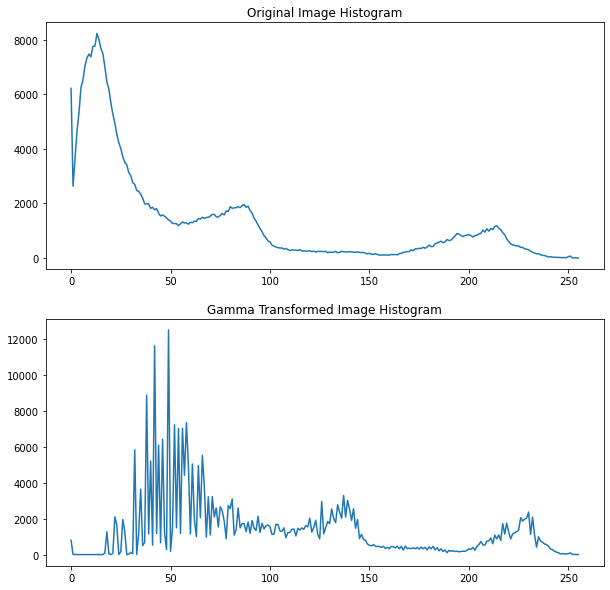

In [31]:
Img3 = cv.imread(r"highlights_and_shadows.jpg")
assert Img3 is not None

gamma = 0.5
Lab_Img3 = cv.cvtColor(Img3, cv.COLOR_BGR2Lab)
L,a,b=cv.split(Lab_Img3)

Gamma_Trans = np.array([(p/255)**gamma*255 for p in range(0,256)]).astype(np.uint8)
L_trans =  cv.LUT(L,Gamma_Trans)
Lab_Img3[:,:,0] = L_trans

Out_Img3 = cv.cvtColor(Lab_Img3, cv.COLOR_Lab2BGR).astype("uint8")

RGB_Img3 = cv.cvtColor(Img3, cv.COLOR_BGR2RGB).astype("uint8")
RGB_Out_Img3 = cv.cvtColor(Out_Img3, cv.COLOR_BGR2RGB).astype("uint8")

#Gamma Correction
fig, ax = plt.subplots(1, 2, figsize=(10,10))
ax[0].axis('off')
ax[0].title.set_text("Original Image")
ax[0].imshow(RGB_Img3)
ax[1].axis('off')
ax[1].title.set_text("After the Gamma Transformation")
ax[1].imshow(RGB_Out_Img3)

#Histograms of the images
hist_Input = cv.calcHist([Img3], [0], None, [256], [0,256])
hist_Output = cv.calcHist([Out_Img3], [0], None, [256], [0,256])

fig, ax = plt.subplots(2,1, figsize=(10,10))
ax[0].title.set_text("Original Image Histogram")
ax[0].plot(hist_Input )
ax[1].title.set_text("Gamma Transformed Image Histogram")
ax[1].plot(hist_Output )

(-0.5, 499.5, 499.5, -0.5)

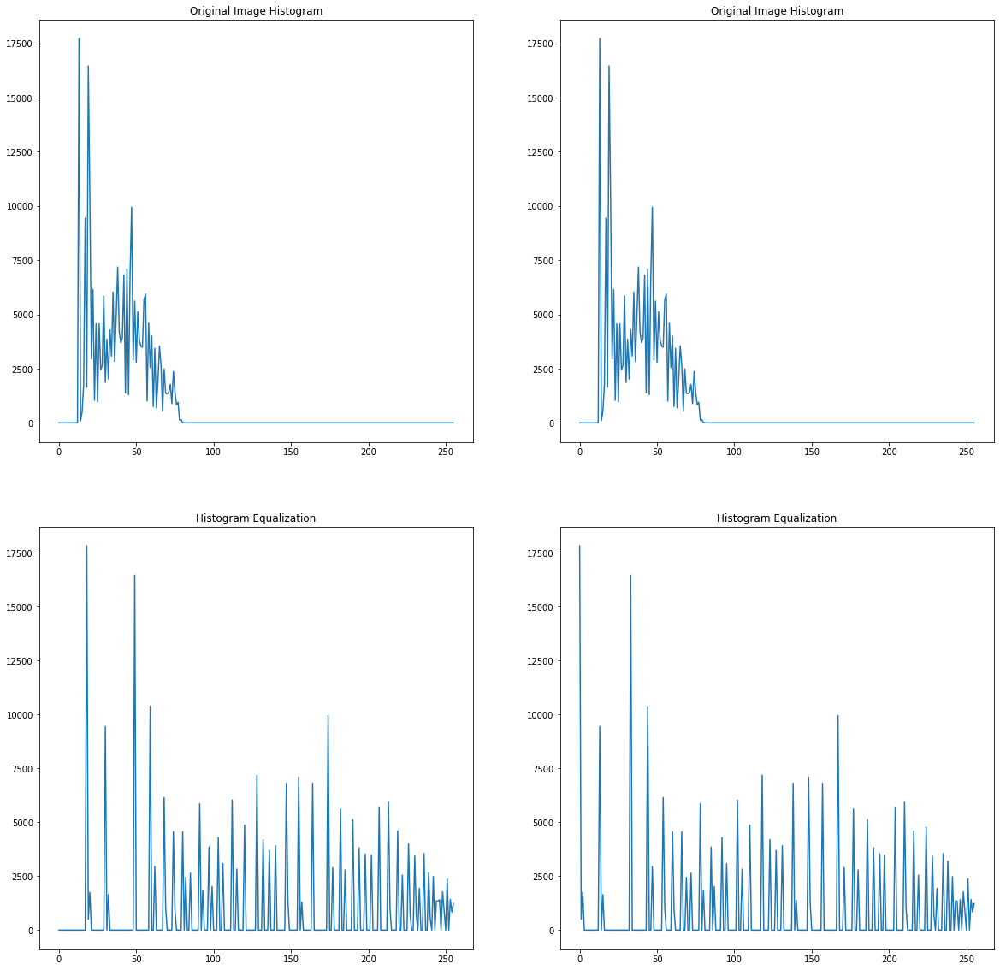

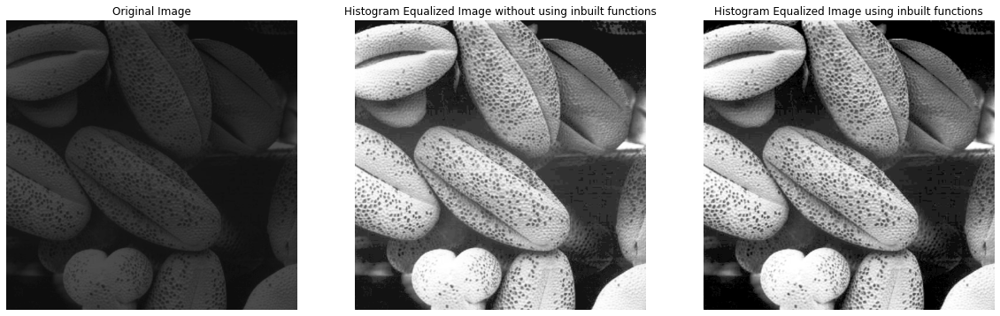

In [22]:
#Ques 4 
import math

img = cv.imread(r"shells.png", cv.IMREAD_GRAYSCALE)
img2 = cv.imread(r"shells.png", cv.IMREAD_GRAYSCALE)

img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB).astype("uint8")
a = np.zeros((256,),dtype=np.float32)
height,width=img.shape

for i in range(width):
    for j in range(height):
        g = img[j,i]
        a[g] = a[g]+1  
        
MN = 1.0/(height*width)
b = np.zeros((256,))

for i in range(256):
    for j in range(i+1):
        b[i] += a[j]
    b[i] = round(b[i] * 255 * MN)

b=b.astype(np.uint8)
Equalizer = np.zeros((256,))
for i in range(width):
    for j in range(height):
        g = img[j,i]
        img[j,i]= b[g]
for i in range(width):
    for j in range(height):
        g = img[j,i]
        Equalizer[g] = Equalizer[g] + 1  



hist_f = cv.calcHist([img2], [0], None, [256], [0,256])
g = cv.equalizeHist(img)
hist_g = cv.calcHist([g], [0], None, [256], [0,256])

fig, ax = plt.subplots(2,2, figsize=(20,20))
ax[0,0].plot(a)
ax[0,0].title.set_text("Original Image Histogram")
ax[1,0].plot(Equalizer)
ax[1,0].title.set_text("Histogram Equalization")
ax[0,1].plot(hist_f)
ax[1,1].plot(hist_g)
ax[0,1].title.set_text("Original Image Histogram")
ax[1,1].title.set_text("Histogram Equalization")

img = cv.cvtColor(img, cv.COLOR_BGR2RGB).astype("uint8")
fig, ax = plt.subplots(1,3, figsize=(20,20))
ax[0].title.set_text("Original Image")
ax[0].imshow(img2)
ax[0].axis('off')
ax[1].title.set_text("Histogram Equalized Image without using inbuilt functions")
ax[1].imshow(img)
ax[1].axis('off')
ax[2].title.set_text("Histogram Equalized Image using inbuilt functions")
ax[2].imshow(g, cmap='gray')
ax[2].axis('off')

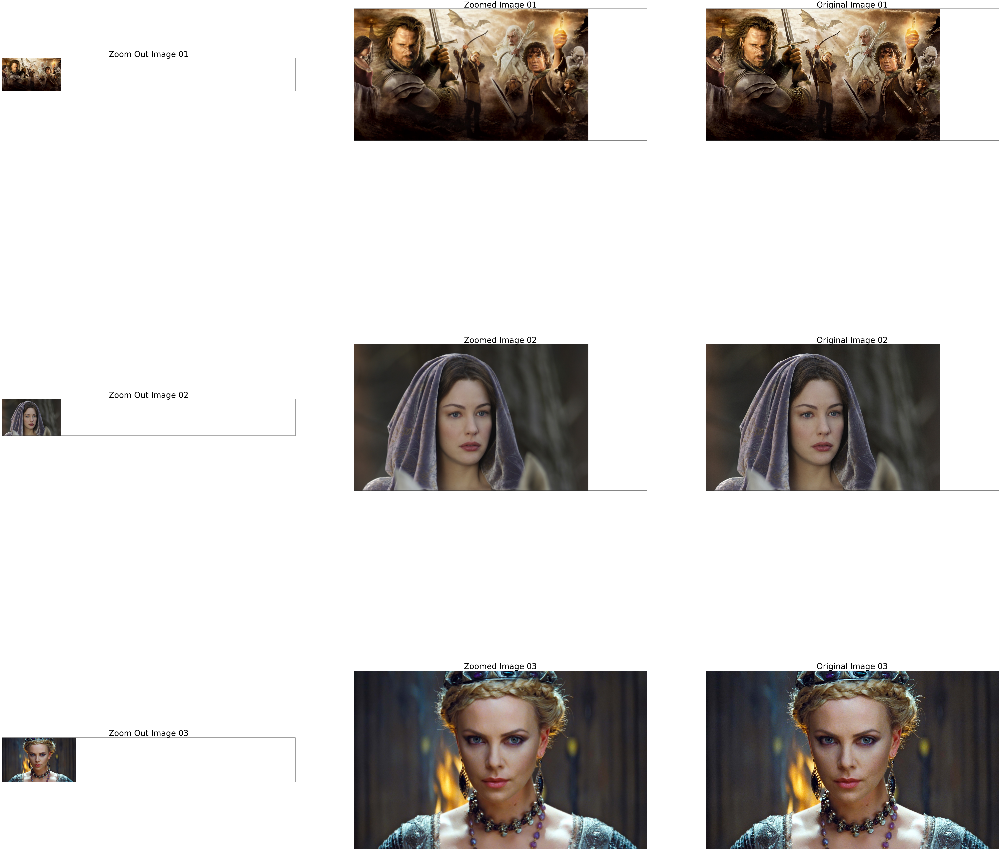

(365, 600, 3)
(1460, 2400, 3)
(1459, 2400, 3)
Normalized Sum of Squared Difference between Zoomed Image 01 and Original Image 01 : 39.257033179012346
Normalized Sum of Squared Difference between Zoomed Image 02 and Original Image 02 : 16.21177662037037


In [37]:
Img1 = cv.imread(r"a1q5images/im01small.png")
Img1_Zoomed = cv.imread(r"a1q5images/im01.png")
Img2 = cv.imread(r"a1q5images/im02small.png")
Img2_Zoomed = cv.imread(r"a1q5images/im02.png")
Img3 = cv.imread(r"a1q5images/im03small.png")
Img3_Zoomed = cv.imread(r"a1q5images/im03.png")
assert Img1 is not None
assert Img1_Zoomed  is not None
assert Img2 is not None
assert Img2_Zoomed  is not None
assert Img3 is not None
assert Img3_Zoomed  is not None

scale = 4 # 0 < scale <= 10


def BI_resize(original_img, new_h, new_w):
	old_h, old_w, c = original_img.shape
	resized = np.zeros((new_h, new_w, c))
	w_scale_factor = (old_w ) / (new_w )
	h_scale_factor = (old_h ) / (new_h )
	for i in range(new_h):
		for j in range(new_w):
			x = i * h_scale_factor
			y = j * w_scale_factor

			x_floor = math.floor(x)
			x_ceil = min( old_h - 1, math.ceil(x))
			y_floor = math.floor(y)
			y_ceil = min(old_w - 1, math.ceil(y))

			if (x_ceil == x_floor) and (y_ceil == y_floor):
				q = original_img[int(x), int(y), :]
			elif (x_ceil == x_floor):
				q1 = original_img[int(x), int(y_floor), :]
				q2 = original_img[int(x), int(y_ceil), :]
				q = q1 * (y_ceil - y) + q2 * (y - y_floor)
			elif (y_ceil == y_floor):
				q1 = original_img[int(x_floor), int(y), :]
				q2 = original_img[int(x_ceil), int(y), :]
				q = (q1 * (x_ceil - x)) + (q2	 * (x - x_floor))
			else:
				v1 = original_img[x_floor, y_floor, :]
				v2 = original_img[x_ceil, y_floor, :]
				v3 = original_img[x_floor, y_ceil, :]
				v4 = original_img[x_ceil, y_ceil, :]

				q1 = v1 * (x_ceil - x) + v2 * (x - x_floor)
				q2 = v3 * (x_ceil - x) + v4 * (x - x_floor)
				q = q1 * (y_ceil - y) + q2 * (y - y_floor)
			resized[i,j,:] = q
	return resized.astype(np.uint8)


NewImg1 = BI_resize(Img1, Img1.shape[0]*scale, Img1.shape[1]*scale)
NewImg1 = cv.cvtColor(NewImg1, cv.COLOR_BGR2RGB).astype("uint8")
Img1 = cv.cvtColor(Img1, cv.COLOR_BGR2RGB).astype("uint8")
Img1_Zoomed = cv.cvtColor(Img1_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

NewImg2 = BI_resize(Img2, Img2.shape[0]*scale, Img2.shape[1]*scale)
NewImg2 = cv.cvtColor(NewImg2, cv.COLOR_BGR2RGB).astype("uint8")
Img2 = cv.cvtColor(Img2, cv.COLOR_BGR2RGB).astype("uint8")
Img2_Zoomed = cv.cvtColor(Img2_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

NewImg3 = BI_resize(Img3, Img3.shape[0]*scale, Img3.shape[1]*scale)
NewImg3 = cv.cvtColor(NewImg3, cv.COLOR_BGR2RGB).astype("uint8")
Img3 = cv.cvtColor(Img3, cv.COLOR_BGR2RGB).astype("uint8")
Img3_Zoomed = cv.cvtColor(Img3_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

fig, ax = plt.subplots(3,3, sharex='all', figsize=(90,90))
ax[0,0].imshow(Img1)
ax[0,0].set_title('Zoom Out Image 01', fontsize = 40)
ax[0,0].set_xticks([]), ax[0,0].set_yticks([])
ax[0,1].imshow(NewImg1)
ax[0,1].set_title('Zoomed Image 01', fontsize = 40)
ax[0,1].set_xticks([]), ax[0,1].set_yticks([])
ax[0,2].imshow(Img1_Zoomed)
ax[0,2].set_title('Original Image 01', fontsize = 40)
ax[0,2].set_xticks([]), ax[0,2].set_yticks([])
ax[1,0].imshow(Img2)
ax[1,0].set_title('Zoom Out Image 02', fontsize = 40)
ax[1,0].set_xticks([]), ax[1,0].set_yticks([])
ax[1,1].imshow(NewImg2)
ax[1,1].set_title('Zoomed Image 02', fontsize = 40)
ax[1,1].set_xticks([]), ax[1,1].set_yticks([])
ax[1,2].imshow(Img2_Zoomed)
ax[1,2].set_title('Original Image 02', fontsize = 40)
ax[1,2].set_xticks([]), ax[1,2].set_yticks([])
ax[2,0].imshow(Img3)
ax[2,0].set_title('Zoom Out Image 03', fontsize = 40)
ax[2,0].set_xticks([]), ax[2,0].set_yticks([])
ax[2,1].imshow(NewImg3)
ax[2,1].set_title('Zoomed Image 03', fontsize = 40)
ax[2,1].set_xticks([]), ax[2,1].set_yticks([])
ax[2,2].imshow(Img3_Zoomed)
ax[2,2].set_title('Original Image 03', fontsize = 40)
ax[2,2].set_xticks([]), ax[2,2].set_yticks([])
plt.show()
#normalized sum of squared differnece
N_SMD_1 = np.sum((NewImg1 - Img1_Zoomed)**2)/(NewImg1.shape[0]*NewImg1.shape[1]*NewImg1.shape[2])
N_SMD_2 = np.sum((NewImg2 - Img2_Zoomed)**2)/(NewImg2.shape[0]*NewImg2.shape[1]*NewImg1.shape[2])
#N_SMD_3 = np.sum((NewImg3 - Img3_Zoomed)**2)/(NewImg3.shape[0]*NewImg3.shape[1]*NewImg1.shape[2])
print(Img3.shape)
print(NewImg3.shape)
print(Img3_Zoomed.shape)
print('Normalized Sum of Squared Difference between Zoomed Image 01 and Original Image 01 :', N_SMD_1)
print('Normalized Sum of Squared Difference between Zoomed Image 02 and Original Image 02 :', N_SMD_2)
#print('Normalized Sum of Squared Difference between Zoomed Image 03 and Original Image 03 :', N_SMD_3)

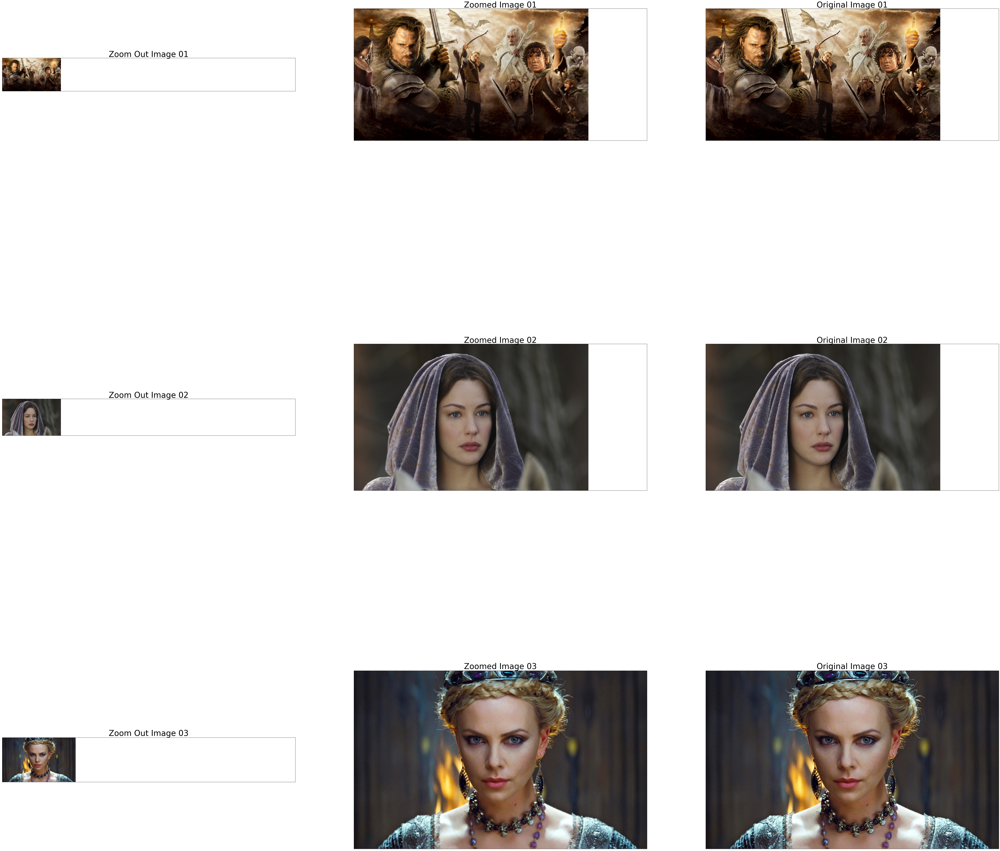

(365, 600, 3)
(1460, 2400, 3)
(1459, 2400, 3)
Normalized Sum of Squared Difference between Zoomed Image 01 and Original Image 01 : 40.11174270190329
Normalized Sum of Squared Difference between Zoomed Image 02 and Original Image 02 : 16.792970920138888


In [48]:
#Ques 5
Img1 = cv.imread(r"a1q5images/im01small.png")
Img1_Zoomed = cv.imread(r"a1q5images/im01.png")
Img2 = cv.imread(r"a1q5images/im02small.png")
Img2_Zoomed = cv.imread(r"a1q5images/im02.png")
Img3 = cv.imread(r"a1q5images/im03small.png")
Img3_Zoomed = cv.imread(r"a1q5images/im03.png")
assert Img1 is not None
assert Img1_Zoomed  is not None
assert Img2 is not None
assert Img2_Zoomed  is not None
assert Img3 is not None
assert Img3_Zoomed  is not None

scale = 4 # 0 < scale <= 10

def NN_resize(original_img, new_h, new_w, scale):
    zoomed_image = np.zeros((new_h,new_w,3))
    for i in range(new_h):
        for j in range(new_w):
            zoomed_image[i][j] = original_img[min(original_img.shape[0] - 1, round(i/scale))][min(original_img.shape[1] - 1, round(j/scale))]
    zoomed_image = zoomed_image.astype('uint8')
    return zoomed_image

NewImg1 = NN_resize(Img1, Img1.shape[0]*scale, Img1.shape[1]*scale, scale)
NewImg1 = cv.cvtColor(NewImg1, cv.COLOR_BGR2RGB).astype("uint8")
Img1 = cv.cvtColor(Img1, cv.COLOR_BGR2RGB).astype("uint8")
Img1_Zoomed = cv.cvtColor(Img1_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

NewImg2 = NN_resize(Img2, Img2.shape[0]*scale, Img2.shape[1]*scale, scale)
NewImg2 = cv.cvtColor(NewImg2, cv.COLOR_BGR2RGB).astype("uint8")
Img2 = cv.cvtColor(Img2, cv.COLOR_BGR2RGB).astype("uint8")
Img2_Zoomed = cv.cvtColor(Img2_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

NewImg3 = NN_resize(Img3, Img3.shape[0]*scale, Img3.shape[1]*scale, scale)
NewImg3 = cv.cvtColor(NewImg3, cv.COLOR_BGR2RGB).astype("uint8")
Img3 = cv.cvtColor(Img3, cv.COLOR_BGR2RGB).astype("uint8")
Img3_Zoomed = cv.cvtColor(Img3_Zoomed, cv.COLOR_BGR2RGB).astype("uint8")

fig, ax = plt.subplots(3,3, sharex='all', figsize=(90,90))
ax[0,0].imshow(Img1)
ax[0,0].set_title('Zoom Out Image 01', fontsize = 40)
ax[0,0].set_xticks([]), ax[0,0].set_yticks([])
ax[0,1].imshow(NewImg1)
ax[0,1].set_title('Zoomed Image 01', fontsize = 40)
ax[0,1].set_xticks([]), ax[0,1].set_yticks([])
ax[0,2].imshow(Img1_Zoomed)
ax[0,2].set_title('Original Image 01', fontsize = 40)
ax[0,2].set_xticks([]), ax[0,2].set_yticks([])
ax[1,0].imshow(Img2)
ax[1,0].set_title('Zoom Out Image 02', fontsize = 40)
ax[1,0].set_xticks([]), ax[1,0].set_yticks([])
ax[1,1].imshow(NewImg2)
ax[1,1].set_title('Zoomed Image 02', fontsize = 40)
ax[1,1].set_xticks([]), ax[1,1].set_yticks([])
ax[1,2].imshow(Img2_Zoomed)
ax[1,2].set_title('Original Image 02', fontsize = 40)
ax[1,2].set_xticks([]), ax[1,2].set_yticks([])
ax[2,0].imshow(Img3)
ax[2,0].set_title('Zoom Out Image 03', fontsize = 40)
ax[2,0].set_xticks([]), ax[2,0].set_yticks([])
ax[2,1].imshow(NewImg3)
ax[2,1].set_title('Zoomed Image 03', fontsize = 40)
ax[2,1].set_xticks([]), ax[2,1].set_yticks([])
ax[2,2].imshow(Img3_Zoomed)
ax[2,2].set_title('Original Image 03', fontsize = 40)
ax[2,2].set_xticks([]), ax[2,2].set_yticks([])
plt.show()
#normalized sum of squared differnece
N_SMD_1 = np.sum((NewImg1 - Img1_Zoomed)**2)/(NewImg1.shape[0]*NewImg1.shape[1]*NewImg1.shape[2])
N_SMD_2 = np.sum((NewImg2 - Img2_Zoomed)**2)/(NewImg2.shape[0]*NewImg2.shape[1]*NewImg1.shape[2])
#N_SMD_3 = np.sum((NewImg3 - Img3_Zoomed)**2)/(NewImg3.shape[0]*NewImg3.shape[1]*NewImg1.shape[2])
print(Img3.shape)
print(NewImg3.shape)
print(Img3_Zoomed.shape)
print('Normalized Sum of Squared Difference between Zoomed Image 01 and Original Image 01 :', N_SMD_1)
print('Normalized Sum of Squared Difference between Zoomed Image 02 and Original Image 02 :', N_SMD_2)
#print('Normalized Sum of Squared Difference between Zoomed Image 03 and Original Image 03 :', N_SMD_3)

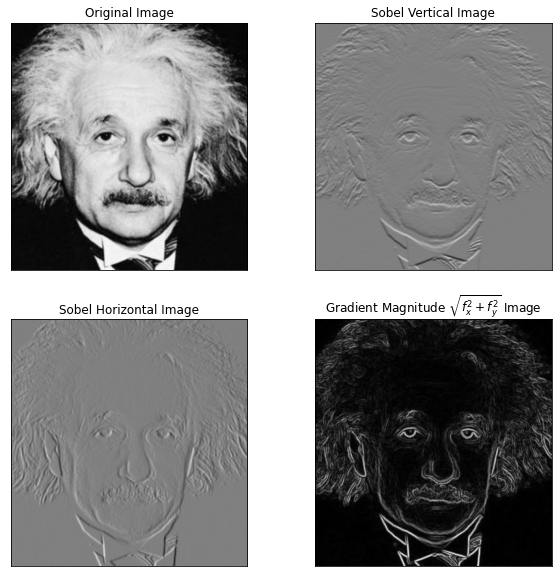

In [37]:
#Ques6 part1
Img5 = cv.imread(r"einstein.png", cv.IMREAD_GRAYSCALE).astype('float32')
assert Img5 is not None

# Vertical x axis
sobel_ver_kernal = np.array([(-1, -2, -1), (0, 0, 0), (1, 2, 1)], dtype='float32')
Img5_x = cv.filter2D(Img5, -1, sobel_ver_kernal)
# Horizontal y axis
sobel_hor_kernal = np.array([(-1, 0, 1), (-2, 0, 2), (-1, 0, 1)], dtype='float32')
Img5_y = cv.filter2D(Img5, -1, sobel_hor_kernal)
Grad_Img5 = np.sqrt(Img5_x**2 + Img5_y**2)

fig, ax = plt.subplots(2,2, sharex='all', figsize=(10,10))
ax[0,0].imshow(Img5, cmap='gray', vmin=0, vmax=255)
ax[0,0].set_title('Original Image')
ax[0,0].set_xticks([]), ax[0,0].set_yticks([])

ax[0,1].imshow(Img5_x, cmap='gray', vmin=-1020, vmax=1020)
ax[0,1].set_title('Sobel Vertical Image')
ax[0,1].set_xticks([]), ax[0,1].set_yticks([])

ax[1,0].imshow(Img5_y, cmap='gray', vmin=-1020, vmax=1020)
ax[1,0].set_title('Sobel Horizontal Image')
ax[1,0].set_xticks([]), ax[1,0].set_yticks([])

ax[1,1].imshow(Grad_Img5, cmap='gray')
ax[1,1].set_title('Gradient Magnitude $\sqrt{f_x^2 + f_y^2}$ Image')
ax[1,1].set_xticks([]), ax[1,1].set_yticks([])
plt.show()

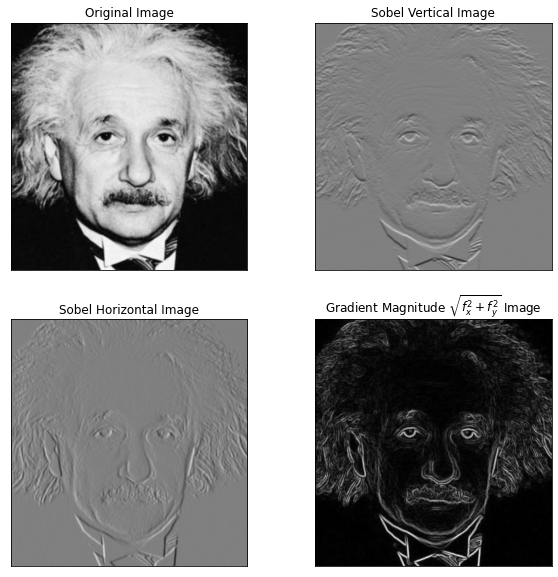

In [18]:
#Ques6 part2

Img5 = cv.imread(r"einstein.png", cv.IMREAD_GRAYSCALE).astype('float32')
assert Img5 is not None

def convolve2d(image, kernel, bias):
    m, n = kernel.shape
    y, x = image.shape
    y = y - m + 1
    x = x - m + 1
    new_image = np.zeros((y,x))
    for i in range(y):
        for j in range(x):
            new_image[i][j] = np.sum(image[i:i+m, j:j+m]*kernel) + bias
    return new_image
# Vertical x axis
sobel_ver_kernal = np.array([(-1, -2, -1), (0, 0, 0), (1, 2, 1)], dtype='float32')
Img5_x = convolve2d(Img5, sobel_ver_kernal, 0)
# Horizontal y axis
sobel_hor_kernal = np.array([(-1, 0, 1), (-2, 0, 2), (-1, 0, 1)], dtype='float32')
Img5_y = convolve2d(Img5, sobel_hor_kernal,0)
Grad_Img5 = np.sqrt(Img5_x**2 + Img5_y**2)

fig, ax = plt.subplots(2,2, sharex='all', figsize=(10,10))
ax[0,0].imshow(Img5, cmap='gray', vmin=0, vmax=255)
ax[0,0].set_title('Original Image')
ax[0,0].set_xticks([]), ax[0,0].set_yticks([])

ax[0,1].imshow(Img5_x, cmap='gray', vmin=-1020, vmax=1020)
ax[0,1].set_title('Sobel Vertical Image')
ax[0,1].set_xticks([]), ax[0,1].set_yticks([])

ax[1,0].imshow(Img5_y, cmap='gray', vmin=-1020, vmax=1020)
ax[1,0].set_title('Sobel Horizontal Image')
ax[1,0].set_xticks([]), ax[1,0].set_yticks([])

ax[1,1].imshow(Grad_Img5, cmap='gray')
ax[1,1].set_title('Gradient Magnitude $\sqrt{f_x^2 + f_y^2}$ Image')
ax[1,1].set_xticks([]), ax[1,1].set_yticks([])
plt.show()

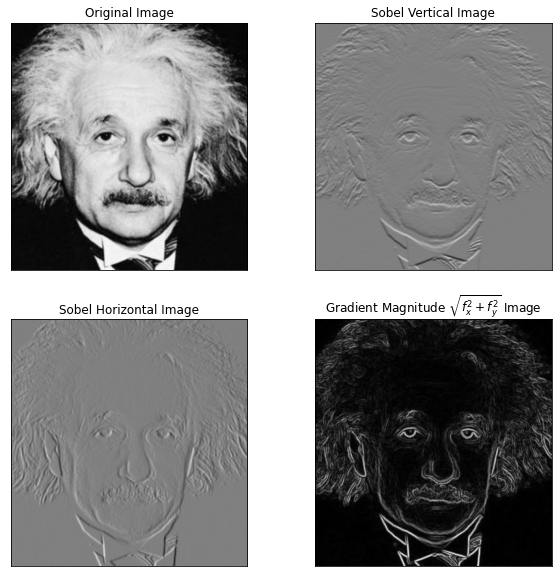

In [25]:
#Ques6 part3
Img5 = cv.imread(r"einstein.png", cv.IMREAD_GRAYSCALE).astype('float32')
assert Img5 is not None

# Vertical x axis
sobel_ver_kernal_1 = np.array([[-1], [0], [1]], dtype='float32')
sobel_ver_kernal_2 = np.array([[1, 2, 1]], dtype='float32')
Img5_x = cv.filter2D(Img5, -1, sobel_ver_kernal_1)
Img5_x = cv.filter2D(Img5_x, -1, sobel_ver_kernal_2)
# Horizontal y axis
sobel_hor_kernal_1 = np.array([[-1], [-2], [-1]], dtype='float32')
sobel_hor_kernal_2 = np.array([[1, 0, -1]], dtype='float32')
Img5_y = cv.filter2D(Img5, -1, sobel_hor_kernal_1)
Img5_y = cv.filter2D(Img5_y, -1, sobel_hor_kernal_2)
Grad_Img5 = np.sqrt(Img5_x**2 + Img5_y**2)

fig, ax = plt.subplots(2,2, sharex='all', figsize=(10,10))
ax[0,0].imshow(Img5, cmap='gray', vmin=0, vmax=255)
ax[0,0].set_title('Original Image')
ax[0,0].set_xticks([]), ax[0,0].set_yticks([])

ax[0,1].imshow(Img5_x, cmap='gray', vmin=-1020, vmax=1020)
ax[0,1].set_title('Sobel Vertical Image')
ax[0,1].set_xticks([]), ax[0,1].set_yticks([])

ax[1,0].imshow(Img5_y, cmap='gray', vmin=-1020, vmax=1020)
ax[1,0].set_title('Sobel Horizontal Image')
ax[1,0].set_xticks([]), ax[1,0].set_yticks([])

ax[1,1].imshow(Grad_Img5, cmap='gray')
ax[1,1].set_title('Gradient Magnitude $\sqrt{f_x^2 + f_y^2}$ Image')
ax[1,1].set_xticks([]), ax[1,1].set_yticks([])
plt.show()

(-0.5, 560.5, 840.5, -0.5)

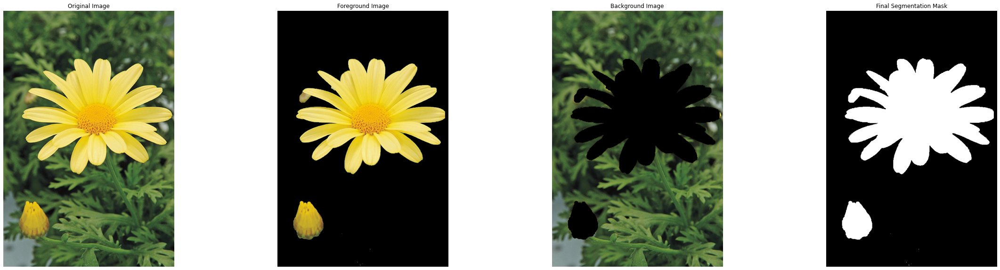

In [23]:
Img = cv.imread(r'daisy.jpg',cv.COLOR_RGB2BGR)

Mask = np.zeros(Img.shape[:2],np.uint8)
BackGModel = np.zeros((1,65),np.float64)
ForeGModel = np.zeros((1,65),np.float64)
rectangle = (50,50,500,800)
cv.grabCut(Img,Mask,rectangle,BackGModel,ForeGModel,5,cv.GC_INIT_WITH_RECT)
Mask1 = np.where((Mask==2)|(Mask==0),0,1).astype('uint8')
ImgFG = Img*Mask1[:,:,np.newaxis]
ImgBG=np.subtract(Img,ImgFG)

fig,ax=plt.subplots(1,4,figsize=(40,10))
ax[0].imshow(cv.cvtColor(Img,cv.COLOR_BGR2RGB))
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(cv.cvtColor(ImgFG,cv.COLOR_BGR2RGB))
ax[1].set_title(r'Foreground Image')
ax[1].axis('off')
ax[2].imshow(cv.cvtColor(ImgBG,cv.COLOR_BGR2RGB))
ax[2].set_title(r'Background Image')
ax[2].axis('off')
ax[3].imshow(cv.cvtColor(Mask1*255,cv.COLOR_BGR2RGB))
ax[3].set_title(r'Final Segmentation Mask')
ax[3].axis('off')

(-0.5, 560.5, 840.5, -0.5)

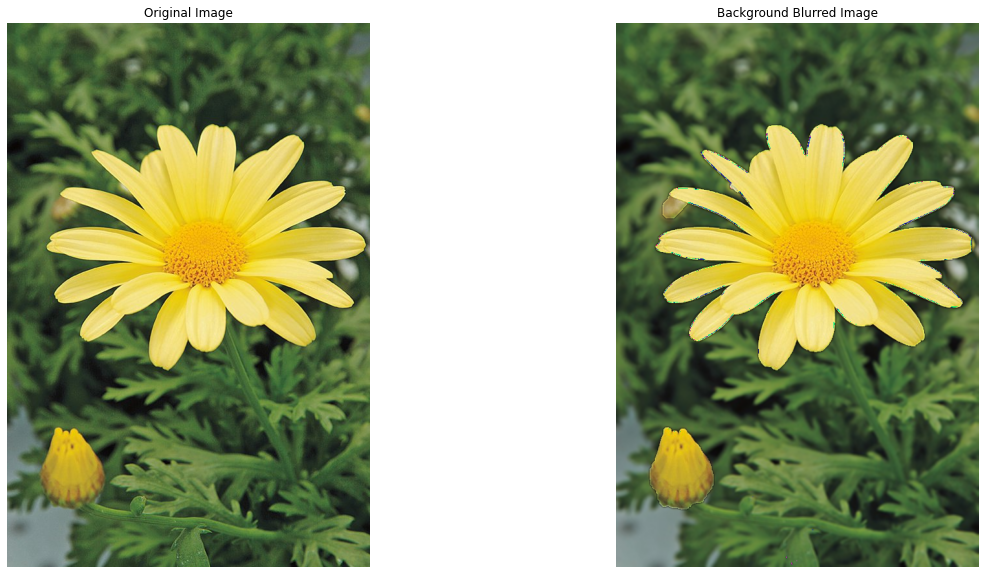

In [24]:
sigma = 2
Gauss_Kernal_1D = cv.getGaussianKernel(5, sigma)
Blurred = cv.sepFilter2D(ImgBG, -1, Gauss_Kernal_1D, Gauss_Kernal_1D)
Back_Blured_Image = np.add(ImgFG, Blurred)

fig,ax=plt.subplots(1,2,figsize=(20,10))
ax[0].imshow(cv.cvtColor(Img,cv.COLOR_BGR2RGB))
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(cv.cvtColor(Back_Blured_Image,cv.COLOR_BGR2RGB))
ax[1].set_title(r'Background Blurred Image')
ax[1].axis('off')